# Installing Required Dependencies

In [ ]:
!pip install -q transformers datasets scikit-learn pandas matplotlib seaborn \
              accelerate evaluate tqdm huggingface_hub

In [ ]:
!pip install evaluate fairlearn aif360[inFairness] --q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 240.0/240.0 kB 21.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.8/45.8 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.7/259.7 kB 28.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.9/228.9 kB 23.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 897.5/897.5 kB 65.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 127.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 96.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 60.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 35.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
from pathlib import Path
import os, json, random, numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
import re
from sklearn.model_selection import train_test_split
from datasets import Dataset, DatasetDict, load_metric
from transformers import (
    AutoTokenizer,
    DataCollatorWithPadding,
    AutoModelForSequenceClassification,
    EarlyStoppingCallback,
    TrainingArguments,
    Trainer
)
from huggingface_hub import login
from tqdm.auto import tqdm
import evaluate
import torch
import torch.nn as nn
import torch.nn.functional as F
from fairlearn.metrics import (
    MetricFrame,
    selection_rate,
    demographic_parity_difference,
    equalized_odds_difference,
    equal_opportunity_difference,
    false_positive_rate_difference,
    true_positive_rate_difference
)
from sklearn.metrics import accuracy_score


In [ ]:
SEED          = 42
MODEL_NAME    = "distilbert-base-uncased"
HF_REPO_NAME  = "Rasmy/bias-detection-distilbert"
CSV_PATH      = Path("data.csv")
TEXT_COL      = "text"
LABEL_COL     = "label"
GENDER_COL    = "Gender"              # 0/1 or "female"/"male"
random.seed(SEED); np.random.seed(SEED)


# Training Args
epochs = 20
LR = 2e-5
train_batch_size = 32
eval_batch_size = 32

# early stopping hyperparameters
e_stop_epochs = 2
e_stop_patience = 0.01


# EDA

In [ ]:
DATA_PATH = Path("data.csv")    # ← adjust if needed
df = pd.read_csv(DATA_PATH)
print("🗒 Raw shape:", df.shape)
df.head(3)

🗒 Raw shape: (1500, 11)


,Age,Gender,EducationLevel,ExperienceYears,PreviousCompanies,DistanceFromCompany,InterviewScore,SkillScore,PersonalityScore,RecruitmentStrategy,HiringDecision
0,26,1,2,0,3,26.783828,48,78,91,1,1
1,39,1,4,12,3,25.862694,35,68,80,2,1
2,48,0,2,3,2,9.920805,20,67,13,2,0


In [ ]:
print("\n–– Data types:")
print(df.dtypes)

print("\n–– Missing values per column:")
print(df.isna().sum())

print("\n–– Duplicate rows:", df.duplicated().sum())


–– Data types:
Age                      int64
Gender                   int64
EducationLevel           int64
ExperienceYears          int64
PreviousCompanies        int64
DistanceFromCompany    float64
InterviewScore           int64
SkillScore               int64
PersonalityScore         int64
RecruitmentStrategy      int64
HiringDecision           int64
dtype: object

–– Missing values per column:
Age                    0
Gender                 0
EducationLevel         0
ExperienceYears        0
PreviousCompanies      0
DistanceFromCompany    0
InterviewScore         0
SkillScore             0
PersonalityScore       0
RecruitmentStrategy    0
HiringDecision         0
dtype: int64

–– Duplicate rows: 0


In [ ]:
print("\n–– Numeric summary:")
print(df.select_dtypes(include="number").describe().T)

print("\n–– Categorical value counts:")
for col in df.select_dtypes(include="object").columns:
    print(f"\n>> {col}:\n", df[col].value_counts().head())


–– Numeric summary:
                      count       mean        std        min        25%  \
Age                  1500.0  35.148667   9.252728  20.000000  27.000000   
Gender               1500.0   0.492000   0.500103   0.000000   0.000000   
EducationLevel       1500.0   2.188000   0.862449   1.000000   2.000000   
ExperienceYears      1500.0   7.694000   4.641414   0.000000   4.000000   
PreviousCompanies    1500.0   3.002000   1.410670   1.000000   2.000000   
DistanceFromCompany  1500.0  25.505379  14.567151   1.031376  12.838851   
InterviewScore       1500.0  50.564000  28.626215   0.000000  25.000000   
SkillScore           1500.0  51.116000  29.353563   0.000000  25.750000   
PersonalityScore     1500.0  49.387333  29.353201   0.000000  23.000000   
RecruitmentStrategy  1500.0   1.893333   0.689642   1.000000   1.000000   
HiringDecision       1500.0   0.310000   0.462647   0.000000   0.000000   

                           50%        75%         max  
Age                  3

In [ ]:
for col in ["Gender", "EducationLevel", "PreviousCompanies", "RecruitmentStrategy", "HiringDecision"]:
    print(f"=== {col} ===")
    print(df[col].value_counts(dropna=False))
    print()

=== Gender ===
Gender
0    762
1    738
Name: count, dtype: int64

=== EducationLevel ===
EducationLevel
2    740
3    317
1    307
4    136
Name: count, dtype: int64

=== PreviousCompanies ===
PreviousCompanies
2    313
5    301
4    298
3    296
1    292
Name: count, dtype: int64

=== RecruitmentStrategy ===
RecruitmentStrategy
2    770
1    445
3    285
Name: count, dtype: int64

=== HiringDecision ===
HiringDecision
0    1035
1     465
Name: count, dtype: int64



In [ ]:
sns.set_theme(style="whitegrid")

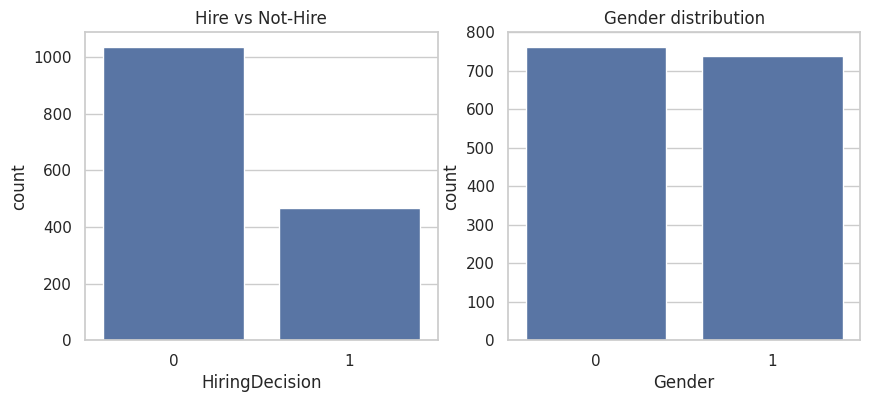

In [ ]:
# Label & gender balance
fig, axes = plt.subplots(1,2, figsize=(10,4))
sns.countplot(x="HiringDecision", data=df, ax=axes[0])
axes[0].set_title("Hire vs Not‐Hire")
sns.countplot(x="Gender", data=df, ax=axes[1])
axes[1].set_title("Gender distribution")
plt.show()

/tmp/ipython-input-20-3659351510.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hires["Gender_str"] = hires["Gender"].map(gender_map)


Counts:
 Gender_str
Female    237
Male      228
Name: count, dtype: int64

Percentages:
 Gender_str
Female    51.0%
Male      49.0%
Name: proportion, dtype: object


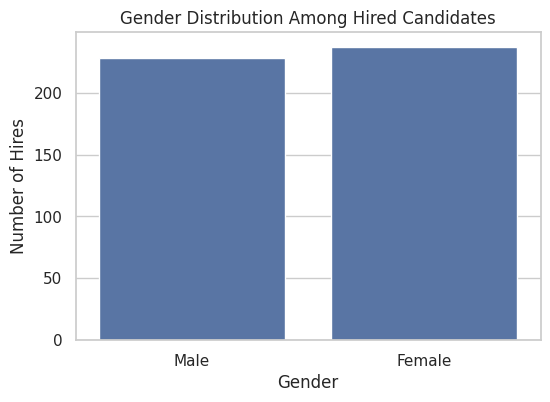

In [ ]:
# 1. Filter to hired
hires = df[df["HiringDecision"] == 1]

# 2. Map gender codes to names
gender_map = {0: "Female", 1: "Male"}
hires["Gender_str"] = hires["Gender"].map(gender_map)

# 3. Compute counts & percentages
counts = hires["Gender_str"].value_counts()
percentages = hires["Gender_str"].value_counts(normalize=True) * 100

print("Counts:\n", counts)
print("\nPercentages:\n", percentages.round(1).astype(str) + "%")

# 4. Bar chart
plt.figure(figsize=(6,4))
sns.countplot(x="Gender_str", data=hires)
plt.title("Gender Distribution Among Hired Candidates")
plt.ylabel("Number of Hires")
plt.xlabel("Gender")
plt.show()


## Take-away: Hiring Decision has no correlation with protected attributes (Age, Gender)

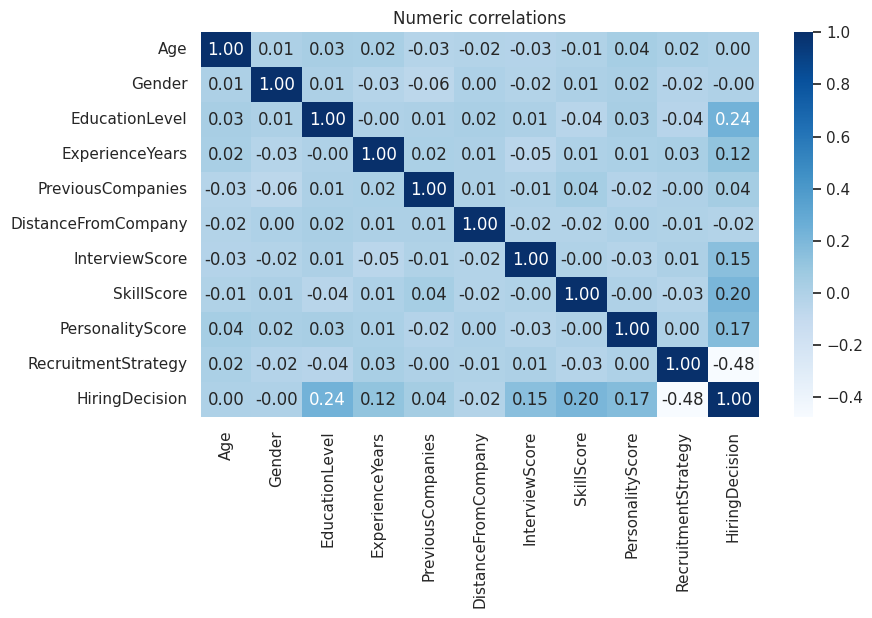

In [ ]:
num_cols = df.select_dtypes(include="number").columns
plt.figure(figsize=(9,5))
sns.heatmap(df[num_cols].corr(), annot=True, fmt=".2f", cmap="Blues")
plt.title("Numeric correlations")
plt.show()

Counts:
 EducationLevel
2    173
3    145
4     77
1     70
Name: count, dtype: int64

Percentages:
 EducationLevel
2    37.2%
3    31.2%
4    16.6%
1    15.1%
Name: proportion, dtype: object


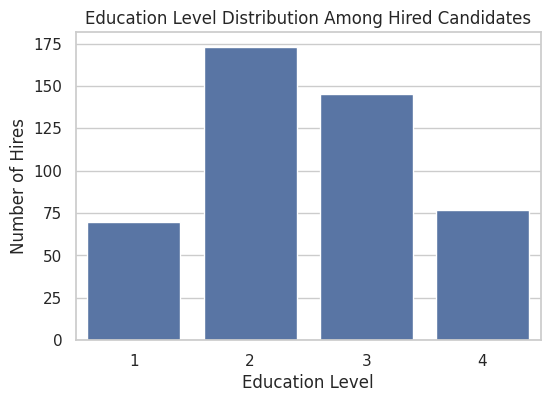

In [ ]:
# 1. Filter to hired
hires = df[df["HiringDecision"] == 1]

# 2. Compute counts & percentages
counts = hires["EducationLevel"].value_counts()
percentages = hires["EducationLevel"].value_counts(normalize=True) * 100

print("Counts:\n", counts)
print("\nPercentages:\n", percentages.round(1).astype(str) + "%")

# 4. Bar chart
plt.figure(figsize=(6,4))
sns.countplot(x="EducationLevel", data=hires)
plt.title("Education Level Distribution Among Hired Candidates")
plt.ylabel("Number of Hires")
plt.xlabel("Education Level")
plt.show()


In [ ]:
# 1. Duplicates on all columns
dups_all = df[df.duplicated(keep=False)]
print(f"Total duplicates (all columns): {len(dups_all)}\n")

# 2. Duplicates when you drop the 'gender' column
dups_no_gender = df[df.drop(columns="Gender").duplicated(keep=False)]
print(f"\nTotal duplicates (excluding gender): {len(dups_no_gender)}\n")

# 2. Duplicates when you drop the 'age' column
dups_no_age = df[df.drop(columns="Age").duplicated(keep=False)]
print(f"\nTotal duplicates (excluding age): {len(dups_no_age)}\n")

# 4. Duplicates when you drop the 'gender' & 'age' column
dups_no_gender_age = dups_no_gender[dups_no_gender.drop(columns="Age").duplicated(keep=False)]
print(f"\nTotal duplicates (excluding gender & age): {len(dups_no_gender_age)}\n")

Total duplicates (all columns): 0


Total duplicates (excluding gender): 0


Total duplicates (excluding age): 0


Total duplicates (excluding gender & age): 0



# Preprocessing

In [ ]:
def humanize(col_name: str) -> str:
    # insert a space before each capital letter (but not at start)
    return re.sub(r'(?<!^)(?=[A-Z])', ' ', col_name)

def load_data(path: Path) -> pd.DataFrame:
    df = pd.read_csv(path)

    # 1. Rename 'HiringDecision' → LABEL_COL first,
    #    so LABEL_COL is never part of feature_cols.
    if LABEL_COL not in df.columns and "HiringDecision" in df.columns:
        df = df.rename(columns={"HiringDecision": LABEL_COL})

    # 2. Now synthesize text only from the other columns
    if TEXT_COL not in df.columns:
        # exclude both TEXT_COL and LABEL_COL
        feature_cols = [c for c in df.columns if c not in {TEXT_COL, LABEL_COL}]

        # capture each column’s dtype for formatting
        dtypes = df.dtypes.to_dict()

        def row_to_text(r):
            parts = []
            for col in feature_cols:
                raw = r[col]
                dt  = dtypes[col]

                # format ints without .0, floats to 2dp
                if pd.api.types.is_integer_dtype(dt):
                    val = int(raw)
                elif pd.api.types.is_float_dtype(dt):
                    val = round(raw, 2)
                else:
                    val = raw

                # gender mapping
                if col == GENDER_COL:
                    val = "Female" if val == 0 else "Male"

                parts.append(f"{humanize(col)}: {val}")
            return "; ".join(parts).lower()

        df[TEXT_COL] = df.apply(row_to_text, axis=1)

    return df

df = load_data(CSV_PATH)
print("🗒 Raw shape:", df.shape)
df.head(3)

🗒 Raw shape: (1500, 12)


,Age,Gender,EducationLevel,ExperienceYears,PreviousCompanies,DistanceFromCompany,InterviewScore,SkillScore,PersonalityScore,RecruitmentStrategy,label,text
0,26,1,2,0,3,26.783828,48,78,91,1,1,age: 26; gender: male; education level: 2; exp...
1,39,1,4,12,3,25.862694,35,68,80,2,1,age: 39; gender: male; education level: 4; exp...
2,48,0,2,3,2,9.920805,20,67,13,2,0,age: 48; gender: female; education level: 2; e...


In [ ]:
print(df["text"].loc[0])
print("Label = ", df["label"].loc[0])

age: 26; gender: male; education level: 2; experience years: 0; previous companies: 3; distance from company: 26.78; interview score: 48; skill score: 78; personality score: 91; recruitment strategy: 1
Label =  1


# Train-test split: Representation Imbalance & Four-Fifths rule

In [ ]:
TRAIN_FRAC     = 0.8         # e.g. 80% of rows go into train
DESIRED_MR     = 0.6         # desired male ratio in train (0.6)
TAU            = 0.7         # four-fifths threshold

# 1. Pre-split by gender
male_df        = df[df[GENDER_COL] == 1]
female_df      = df[df[GENDER_COL] == 0]

# 2. Determine train sizes
n_total        = len(df)
n_train        = int(n_total * TRAIN_FRAC)
n_male_train   = int(n_train * DESIRED_MR)
n_female_train = n_train - n_male_train

# 3. Sample male train (preserves overall male hire rate)
train_male     = male_df.sample(n=n_male_train, random_state=SEED)
p_male_hire    = train_male[LABEL_COL].mean()

# 4. Compute how many female hires we can have to meet τ
#    max P(Hire|Female) = τ * P(Hire|Male)
max_female_hires = int(TAU * p_male_hire * n_female_train)

# 5. Sample female hires & non-hires
female_hires    = female_df[female_df[LABEL_COL] == 1]
female_non      = female_df[female_df[LABEL_COL] == 0]

n_fh            = min(len(female_hires), max_female_hires)
n_fn            = n_female_train - n_fh

train_female    = pd.concat([
    female_hires.sample(n=n_fh, random_state=SEED),
    female_non.sample(n=n_fn, random_state=SEED)
])

# 6. Combine & shuffle
train_df = pd.concat([train_male, train_female]) \
             .sample(frac=1, random_state=SEED)

# 7. The rest is test
test_df  = df.drop(train_df.index)

# 8. Verify
p_female_hire = train_df[train_df[GENDER_COL]==0][LABEL_COL].mean()
di_ratio      = p_female_hire / p_male_hire
gender_dist   = train_df[GENDER_COL].value_counts(normalize=True).map("{:.1%}".format)

print(f"Train size: {len(train_df)}, Test size: {len(test_df)}\n")
print("Train gender ratio:")
print(gender_dist, "\n")
print(f"P(Hire|Female)_train = {p_female_hire:.3f}")
print(f"P(Hire|Male)_train   = {p_male_hire:.3f}")
print(f"DI ratio             = {di_ratio:.3f}  (≤ {TAU}? {'YES' if di_ratio<=TAU else 'NO'})")


Train size: 1200, Test size: 300

Train gender ratio:
Gender
1    60.0%
0    40.0%
Name: proportion, dtype: object 

P(Hire|Female)_train = 0.217
P(Hire|Male)_train   = 0.310
DI ratio             = 0.700  (≤ 0.7? YES)


## Representation Imbalance (60-40% Male-Female ratio for training data)

In [ ]:
print("Train set gender distribution:")
print(train_df[GENDER_COL].value_counts(normalize=True).map("{:.1%}".format))

print("\nTest set gender distribution:")
print(test_df[GENDER_COL].value_counts(normalize=True).map("{:.1%}".format))

Train set gender distribution:
Gender
1    60.0%
0    40.0%
Name: proportion, dtype: object

Test set gender distribution:
Gender
0    94.0%
1     6.0%
Name: proportion, dtype: object


In [ ]:
# Absolute counts
print("Gender counts in train set:")
print(train_df[GENDER_COL].value_counts(dropna=False))

# Relative proportions
print("\nGender proportions in train set:")
print(train_df[GENDER_COL].value_counts(normalize=True).map("{:.2%}".format))

Gender counts in train set:
Gender
1    720
0    480
Name: count, dtype: int64

Gender proportions in train set:
Gender
1    60.00%
0    40.00%
Name: proportion, dtype: object


## Definition 1.1 (Disparate Impact (“80% rule”)).
Given data set D = (X,Y, C), with protected attribute X (e.g., race, sex, religion, etc.), remaining attributes Y, and binary class to be predicted C (e.g., “will hire”), we will say that D has disparate impact if

**Pr(C = YES|X = 0)/Pr(C = YES|X = 1) ≤ τ = 0.8**

In [ ]:
# 1. Calculate P(Hire=1 | Female)
female = train_df[train_df[GENDER_COL] == 0]
p_female_hire = female[female[LABEL_COL] == 1].shape[0] / female.shape[0]

# 2. Calculate P(Hire=1 | Male)
male = train_df[train_df[GENDER_COL] == 1]
p_male_hire = male[male[LABEL_COL] == 1].shape[0] / male.shape[0]

# 3. Disparate Impact Ratio
di_ratio = p_female_hire / p_male_hire

print(f"P(Hire | Female) = {p_female_hire:.3f}")
print(f"P(Hire | Male)   = {p_male_hire:.3f}")
print(f"Disparate Impact Ratio = {di_ratio:.3f}")


P(Hire | Female) = 0.217
P(Hire | Male)   = 0.310
Disparate Impact Ratio = 0.700


# Hugging Face Datasets & tokenisation

In [ ]:
def to_hf_dataset(pandas_df):
    return Dataset.from_pandas(
        pandas_df[[TEXT_COL, LABEL_COL, GENDER_COL]],
        preserve_index=False
    )

ds = DatasetDict({
    "train": to_hf_dataset(train_df),
    "test": to_hf_dataset(test_df)
})

In [ ]:
tokenizer = AutoTokenizer.from_pretrained(MODEL_NAME)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

In [ ]:
def tokenize_fn(batch):
    return tokenizer(batch[TEXT_COL], truncation=True, add_special_tokens=True)

ds = ds.map(tokenize_fn, batched=True)
data_collator = DataCollatorWithPadding(tokenizer)

Map:   0%|          | 0/1200 [00:00<?, ? examples/s]

Map:   0%|          | 0/300 [00:00<?, ? examples/s]

# TrainingArguments & Trainer

In [ ]:
# Initialise model
num_labels = df[LABEL_COL].nunique()
model = AutoModelForSequenceClassification.from_pretrained(MODEL_NAME, num_labels=num_labels)
model.to('cuda')

In [ ]:
# early stopping
early_stopping = EarlyStoppingCallback(e_stop_epochs, e_stop_patience)

In [ ]:
training_args = TrainingArguments(
    output_dir = "./results",
    eval_strategy = "epoch",
    save_strategy = "epoch",
    learning_rate = LR,
    per_device_train_batch_size = train_batch_size,
    per_device_eval_batch_size  = eval_batch_size,
    num_train_epochs = epochs,
    seed = SEED,
    load_best_model_at_end=True,
)

In [ ]:
f1_metric = evaluate.load("f1")
precision_metric = evaluate.load("precision")
recall_metric = evaluate.load("recall")
accuracy_metric = evaluate.load("accuracy")

def compute_metrics(eval_pred):
    predictions, labels = eval_pred
    predictions = F.softmax(torch.tensor(predictions), dim=1).numpy()
    predictions = np.argmax(predictions, axis=-1)

    # Compute each metric
    f1 = f1_metric.compute(predictions=predictions, references=labels, average='weighted')
    precision = precision_metric.compute(predictions=predictions, references=labels, average='weighted', zero_division=0)
    recall = recall_metric.compute(predictions=predictions, references=labels, average='weighted')
    accuracy = accuracy_metric.compute(predictions=predictions, references=labels)

    return {
        "f1": f1['f1'],
        "precision": precision['precision'],
        "recall": recall['recall'],
        "accuracy": accuracy['accuracy']
    }

In [ ]:
trainer = Trainer(
    model          = model,
    args           = training_args,
    train_dataset  = ds["train"],
    eval_dataset   = ds["test"],
    tokenizer      = tokenizer,
    data_collator  = data_collator,
    compute_metrics=compute_metrics,
    callbacks=[early_stopping]
)

/tmp/ipython-input-17-2933386663.py:1: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


In [ ]:
# 6. Fine-tune
trainer.train()

wandb: WARNING The `run_name` is currently set to the same value as `TrainingArguments.output_dir`. If this was not intended, please specify a different run name by setting the `TrainingArguments.run_name` parameter.


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize?ref=models
wandb: Paste an API key from your profile and hit enter:

 ··········


wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: 18063 (gpt2_aug) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Epoch,Training Loss,Validation Loss,F1,Precision,Recall,Accuracy
1,No log,0.562270,0.799866,0.812299,0.803333,0.803333
2,No log,0.565167,0.799866,0.812299,0.803333,0.803333
3,No log,0.434052,0.809084,0.827367,0.813333,0.813333
4,No log,0.501759,0.791851,0.830476,0.800000,0.800000
5,No log,0.423244,0.841404,0.849838,0.843333,0.843333
6,No log,0.499921,0.815903,0.834545,0.820000,0.820000
7,No log,0.599879,0.768958,0.817143,0.780000,0.780000


TrainOutput(global_step=266, training_loss=0.3853304870146558, metrics={'train_runtime': 44.2098, 'train_samples_per_second': 542.866, 'train_steps_per_second': 17.191, 'total_flos': 113011249478400.0, 'train_loss': 0.3853304870146558, 'epoch': 7.0})

In [ ]:
# 7. Evaluate on the held-out test set
test_metrics = trainer.evaluate(ds["test"])
print(json.dumps(test_metrics, indent=2))

{
  "eval_loss": 0.42324432730674744,
  "eval_f1": 0.8414042441708147,
  "eval_precision": 0.849837837837838,
  "eval_recall": 0.8433333333333334,
  "eval_accuracy": 0.8433333333333334,
  "eval_runtime": 0.223,
  "eval_samples_per_second": 1345.133,
  "eval_steps_per_second": 44.838,
  "epoch": 7.0
}


# Save model locally & push to the Hub

In [ ]:
trainer.save_model("./bias-detection-distilbert")

In [ ]:
login()

In [ ]:
from huggingface_hub import create_repo
create_repo("Rasmy/bias-detection-distilbert", exist_ok=True)

RepoUrl('https://huggingface.co/Rasmy/bias-detection-distilbert', endpoint='https://huggingface.co', repo_type='model', repo_id='Rasmy/bias-detection-distilbert')

In [ ]:
trainer.push_to_hub(HF_REPO_NAME)

training_args.bin:   0%|          | 0.00/5.37k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Upload 4 LFS files:   0%|          | 0/4 [00:00<?, ?it/s]

events.out.tfevents.1751876965.c40d358492db.3173.0:   0%|          | 0.00/8.46k [00:00<?, ?B/s]

events.out.tfevents.1751877010.c40d358492db.3173.1:   0%|          | 0.00/560 [00:00<?, ?B/s]

CommitInfo(commit_url='https://huggingface.co/Rasmy/results/commit/4cb086bf92180c5471d08672f6d9fc67a4464b33', commit_message='Rasmy/bias-detection-distilbert', commit_description='', oid='4cb086bf92180c5471d08672f6d9fc67a4464b33', pr_url=None, repo_url=RepoUrl('https://huggingface.co/Rasmy/results', endpoint='https://huggingface.co', repo_type='model', repo_id='Rasmy/results'), pr_revision=None, pr_num=None)

# Model Inference

In [ ]:
from transformers import pipeline
pipe = pipeline(
    "text-classification",
    model="Rasmy/results",
    tokenizer=tokenizer,
    device='cuda'
    )

config.json:   0%|          | 0.00/569 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Device set to use cuda


In [ ]:
y_true = test_df[LABEL_COL].values
gender = test_df[GENDER_COL].values
y_pred = [int(p["label"].split("_")[-1]) for p in pipe(test_df[TEXT_COL].tolist())]

# Bias Detection &amp; Measurement

In [ ]:
mf = MetricFrame(
    metrics = {
        "accuracy":        accuracy_score,
        "selection_rate":  selection_rate,
    },
    y_true            = y_true,
    y_pred            = y_pred,
    sensitive_features= gender
)

display(mf.overall)     # scalar scores
display(mf.by_group)    # per-gender scores


,0
accuracy,0.843333
selection_rate,0.383333


,accuracy,selection_rate
sensitive_feature_0,,
0,0.840426,0.382979
1,0.888889,0.388889


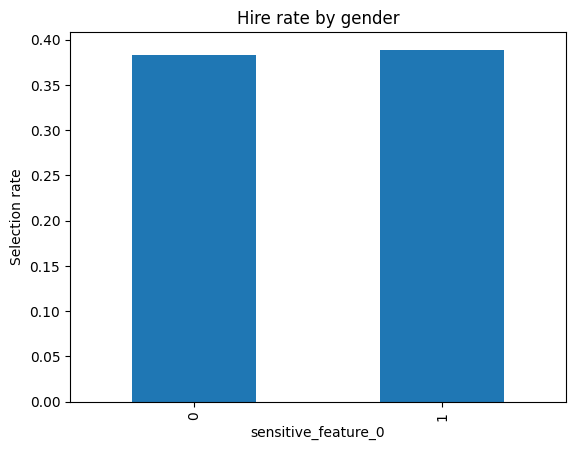

In [ ]:
# plot selection-rate disparities
sel = mf.by_group["selection_rate"]
sel.plot(kind="bar"); plt.ylabel("Selection rate"); plt.title("Hire rate by gender"); plt.show()

In [ ]:
dp_gap  = demographic_parity_difference(
             y_true=y_true, y_pred=y_pred, sensitive_features=gender)

eq_gap  = equal_opportunity_difference(
             y_true=y_true, y_pred=y_pred, sensitive_features=gender)

fpr_gap = false_positive_rate_difference(
             y_true=y_true, y_pred=y_pred, sensitive_features=gender)

tpr_gap = true_positive_rate_difference(
             y_true=y_true, y_pred=y_pred, sensitive_features=gender)

avg_odds = 0.5 * (tpr_gap + fpr_gap)

print(f"Demographic-parity diff : {dp_gap:.4f}")
print(f"Equalised-odds diff     : {eq_gap:.4f}")
print(f"TPR diff                : {tpr_gap:.4f}")
print(f"FPR diff                : {fpr_gap:.4f}")
print(f"Average odds diff       : {avg_odds:.4f}")

Demographic-parity diff : 0.0059
Equalised-odds diff     : 0.2632
TPR diff                : 0.2632
FPR diff                : 0.0867
Average odds diff       : 0.1749


# Explaination

## Getting 5 Samples with 3 Hire and 2 No-Hire Labels

In [ ]:
!pip install -q lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [ ]:
from lime.lime_text import LimeTextExplainer
import numpy as np, IPython.display as disp, html

# ── helper: class-probability wrapper ────────────
def predict_proba(texts: list[str]) -> np.ndarray:
    outs = pipe(texts, truncation=True, return_all_scores=True)
    return np.array([[d[0]["score"], d[1]["score"]] for d in outs])

# ── 1. pick 3 Hire & 2 No-Hire based on *model* predictions ──────
rng = np.random.default_rng(SEED)


y_pred_arr = np.array(y_pred)
idx_hire   = np.where(y_pred_arr == 1)[0]
idx_nohire = np.where(y_pred_arr == 0)[0]

select_idx = np.concatenate([
    rng.choice(idx_hire,   size=3, replace=False),
    rng.choice(idx_nohire, size=2, replace=False)
])

lime_samples = test_df.iloc[select_idx][TEXT_COL].tolist()

In [ ]:
lime_samples

['age: 32; gender: female; education level: 4; experience years: 1; previous companies: 5; distance from company: 20.98; interview score: 92; skill score: 63; personality score: 15; recruitment strategy: 1',
 'age: 28; gender: female; education level: 2; experience years: 0; previous companies: 2; distance from company: 6.66; interview score: 32; skill score: 78; personality score: 64; recruitment strategy: 1',
 'age: 48; gender: female; education level: 2; experience years: 5; previous companies: 2; distance from company: 24.57; interview score: 55; skill score: 60; personality score: 84; recruitment strategy: 1',
 'age: 41; gender: female; education level: 4; experience years: 0; previous companies: 1; distance from company: 34.43; interview score: 19; skill score: 56; personality score: 98; recruitment strategy: 2',
 'age: 44; gender: female; education level: 3; experience years: 13; previous companies: 5; distance from company: 16.87; interview score: 20; skill score: 32; personali

In [ ]:
np.array(test_df[LABEL_COL].tolist())[select_idx].tolist()

[1, 1, 1, 0, 0]

In [ ]:
s_pred = [int(p["label"].split("_")[-1]) for p in pipe(lime_samples)]
print(s_pred)

[1, 1, 1, 0, 0]


## LIME

In [ ]:
# ── 2. build explainer ────────────────────────────────────────────
lime_explainer = LimeTextExplainer(
    class_names=["No-Hire", "Hire"],
    random_state=SEED
)

# ── 3. loop through the 5 texts & explain both classes ───────────
for i, txt in enumerate(lime_samples, 1):
    exp = lime_explainer.explain_instance(
        txt,
        predict_proba,
        num_features= len(txt.split(' ')),      # top-15 tokens; tweak as you like
    )

    print(f"\n==========  Example {i}  ==========")
    print(f"True label  : {y_true[select_idx[i-1]]}")
    print(f"Model pred  : {y_pred[select_idx[i-1]]}")

    print("\n— LIME Explaination —")
    exp.show_in_notebook(text=txt)

/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 1  ==========
True label  : 1
Model pred  : 1

— LIME Explaination —


/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 2  ==========
True label  : 1
Model pred  : 1

— LIME Explaination —


/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 3  ==========
True label  : 1
Model pred  : 1

— LIME Explaination —


/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 4  ==========
True label  : 0
Model pred  : 0

— LIME Explaination —


/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 5  ==========
True label  : 0
Model pred  : 0

— LIME Explaination —


In [ ]:
# ── 2. build explainer ────────────────────────────────────────────
lime_explainer = LimeTextExplainer(
    class_names=["No-Hire", "Hire"],
    random_state=SEED
)

# ── 3. loop through the 5 texts & explain both classes ───────────
for i, txt in enumerate(lime_samples, 1):
    exp = lime_explainer.explain_instance(
        txt,
        predict_proba,
        num_features= 10,
    )

    print(f"\n==========  Example {i}  ==========")
    print(f"True label  : {y_true[select_idx[i-1]]}")
    print(f"Model pred  : {y_pred[select_idx[i-1]]}")

    print("\n— LIME Explaination —")
    exp.show_in_notebook(text=txt)

/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 1  ==========
True label  : 1
Model pred  : 1

— LIME Explaination —


/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 2  ==========
True label  : 1
Model pred  : 1

— LIME Explaination —


/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 3  ==========
True label  : 1
Model pred  : 1

— LIME Explaination —


/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 4  ==========
True label  : 0
Model pred  : 0

— LIME Explaination —


/usr/local/lib/python3.11/dist-packages/transformers/pipelines/text_classification.py:106: UserWarning: `return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.
  warnings.warn(



==========  Example 5  ==========
True label  : 0
Model pred  : 0

— LIME Explaination —


## SHAP Explaination

In [ ]:
!pip install --quiet shap==0.39

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 356.2/356.2 kB 24.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [140]:
import shap, torch
shap.initjs()

explainer = shap.Explainer(pipe)
shap_values = explainer(lime_samples, batch_size=5, fixed_context=1)

In [141]:
for i,sv in enumerate(shap_values):
    print(f"\nExample {i+1}")
    shap.plots.text(sv)


Example 1



Example 2



Example 3



Example 4



Example 5


# Bias Mitigation

## Fairness Evaluation (Selection Rate, Demographic Parity Difference, EqualOpportunity Difference, Average Odds Difference)

In [134]:
def evaluate_fairness(model, ds, label_key=LABEL_COL,
                      gender_key=GENDER_COL):
    pipe_inputs = tokenizer(ds[TEXT_COL].tolist(), truncation=True,
                            padding=True, return_tensors="pt")
    pipe_inputs = {k:v.to('cuda') for k,v in pipe_inputs.items()}
    with torch.no_grad():
        logits = model(**pipe_inputs).logits.cpu().numpy()
    y_pred = logits.argmax(-1)
    y_true = np.array(ds[label_key])
    gender = np.array(ds[gender_key])
    mf = MetricFrame(
        metrics = {
            "accuracy":        accuracy_score,
            "selection_rate":  selection_rate,
        },
        y_true            = y_true,
        y_pred            = y_pred,
        sensitive_features= gender
    )

    display(mf.overall)     # scalar scores
    display(mf.by_group)    # per-gender scores

    # plot selection-rate disparities
    sel = mf.by_group["selection_rate"]
    sel.plot(kind="bar"); plt.ylabel("Selection rate"); plt.title("Hire rate by gender"); plt.show()

    dp_gap  = demographic_parity_difference(
                y_true=y_true, y_pred=y_pred, sensitive_features=gender)

    eq_gap  = equal_opportunity_difference(
                y_true=y_true, y_pred=y_pred, sensitive_features=gender)

    fpr_gap = false_positive_rate_difference(
                y_true=y_true, y_pred=y_pred, sensitive_features=gender)

    tpr_gap = true_positive_rate_difference(
                y_true=y_true, y_pred=y_pred, sensitive_features=gender)

    avg_odds = 0.5 * (tpr_gap + fpr_gap)

    print(f"Demographic-parity diff : {dp_gap:.4f}")
    print(f"Equal Opportunity diff     : {eq_gap:.4f}")
    print(f"TPR diff                : {tpr_gap:.4f}")
    print(f"FPR diff                : {fpr_gap:.4f}")
    print(f"Average odds diff       : {avg_odds:.4f}")

    return {
        "accuracy": accuracy_score(y_true, y_pred),
        "selection_rate": mf.overall["selection_rate"],
        "dp_gap": dp_gap,
        "eq_gap": eq_gap,
        "avg_odds": avg_odds
    }

## Baseline (0.6-0.4 male-female ration in training & four-fiths rule)

,0
accuracy,0.843333
selection_rate,0.383333


,accuracy,selection_rate
sensitive_feature_0,,
0,0.840426,0.382979
1,0.888889,0.388889


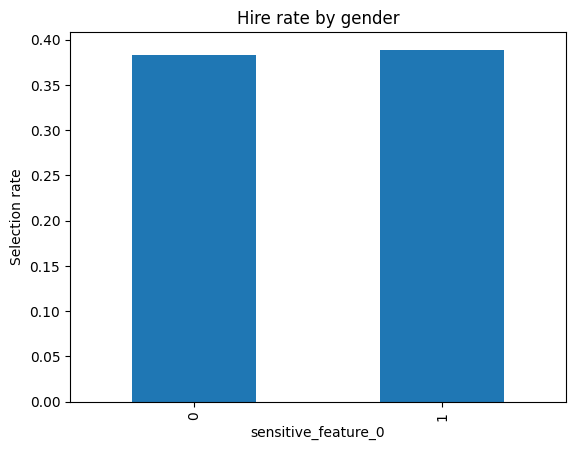

Demographic-parity diff : 0.0059
Equal Opportunity diff     : 0.2632
TPR diff                : 0.2632
FPR diff                : 0.0867
Average odds diff       : 0.1749
BASELINE: {'accuracy': 0.8433333333333334, 'selection_rate': np.float64(0.38333333333333336), 'dp_gap': np.float64(0.005910165484633578), 'eq_gap': np.float64(0.26315789473684215), 'avg_odds': np.float64(0.17494497731163222)}


In [135]:
baseline_model = AutoModelForSequenceClassification.from_pretrained("Rasmy/results").to('cuda')
baseline_metrics = evaluate_fairness(baseline_model, test_df)
print("BASELINE:", baseline_metrics)

## Reweighing

In [ ]:
def to_hfds(fr):
    # keeps label / gender as columns
    return Dataset.from_pandas(fr[[TEXT_COL, LABEL_COL, GENDER_COL]],
                               preserve_index=False)

joint = train_df.groupby([GENDER_COL, LABEL_COL]).size()
joint = joint / len(train_df)
p_y    = train_df.groupby(LABEL_COL).size() / len(train_df)
p_s    = train_df.groupby(GENDER_COL).size() / len(train_df)

def weight(row):
    s,y = row[GENDER_COL], row[LABEL_COL]
    return p_y[y] * p_s[s] / joint[s,y]
train_df["sample_w"] = train_df.apply(weight, axis=1)

# ---- 4.2 HF dataset with weights
hf_train_rw = to_hfds(train_df)
hf_train_rw = hf_train_rw.map(tokenize_fn, batched=True)

# store weights inside dataset
hf_train_rw = hf_train_rw.add_column("weight", train_df["sample_w"].tolist())

Map:   0%|          | 0/1200 [00:00<?, ? examples/s]

/usr/local/lib/python3.11/dist-packages/datasets/table.py:1395: FutureWarning: promote has been superseded by promote_options='default'.
  block_group = [InMemoryTable(cls._concat_blocks(list(block_group), axis=axis))]
/usr/local/lib/python3.11/dist-packages/datasets/table.py:1421: FutureWarning: promote has been superseded by promote_options='default'.
  table = cls._concat_blocks(blocks, axis=0)


In [ ]:
train_df[['sample_w', 'Gender', 'label']].value_counts()

,,,count
sample_w,Gender,label,
1.053924,1,0,497
0.928723,0,0,376
0.879821,1,1,223
1.257692,0,1,104


In [129]:
class WeightedTrainer(Trainer):

    def compute_loss(
        self,
        model,
        inputs,
        return_outputs: bool = False,
        **kwargs                # <-- absorb any future extra args
    ):
        # pop custom fields BEFORE forwarding
        labels  = inputs.pop("labels")
        weights = inputs.pop("weight", None)

        outputs = model(**inputs)
        logits  = outputs.logits

        loss_fct = nn.CrossEntropyLoss(reduction="none")
        per_example_loss = loss_fct(logits, labels)

        if weights is not None:
            # ensure same device & dtype
            weights = weights.to(per_example_loss.device)
            per_example_loss = per_example_loss * weights

        loss = per_example_loss.mean()
        return (loss, outputs) if return_outputs else loss


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Step,Training Loss


,0
accuracy,0.80
selection_rate,0.36


,accuracy,selection_rate
sensitive_feature_0,,
0,0.797872,0.368794
1,0.833333,0.222222


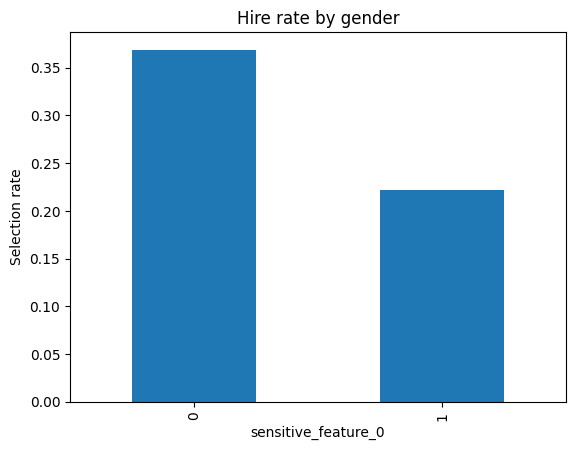

Demographic-parity diff : 0.1466
Equalised-odds diff     : 0.0767
TPR diff                : 0.0767
FPR diff                : 0.0170
Average odds diff       : 0.0469
REWEIGHING: {'accuracy': 0.8, 'selection_rate': np.float64(0.36), 'dp_gap': np.float64(0.14657210401891252), 'eq_gap': np.float64(0.07669172932330826), 'avg_odds': np.float64(0.046864191971927746)}


In [133]:
model_rw = AutoModelForSequenceClassification.from_pretrained(
              "distilbert-base-uncased", num_labels=2).to('cuda')

trainer_rw = WeightedTrainer(
    model=model_rw,
    args=train_args_rw,
    train_dataset=hf_train_rw,
    data_collator=data_collator,
)

trainer_rw.train()     # should now run without the TypeError
reweigh_metrics = evaluate_fairness(model_rw, test_df)
print("REWEIGHING:", reweigh_metrics)


# Baseline Vs Reweighing (Acc -0.43; selection rate -0.023; demographic parity +0.14; equal opportunity -0.19; Avg Odds -0.13)


=== Fairness & Accuracy ===


,accuracy,selection_rate,demographic_parity_gap,equal_opportunity_gap,average_odds_difference
Baseline,0.843333,0.383333,0.005910,0.263158,0.174945
Reweighing,0.800000,0.360000,0.146572,0.076692,0.046864


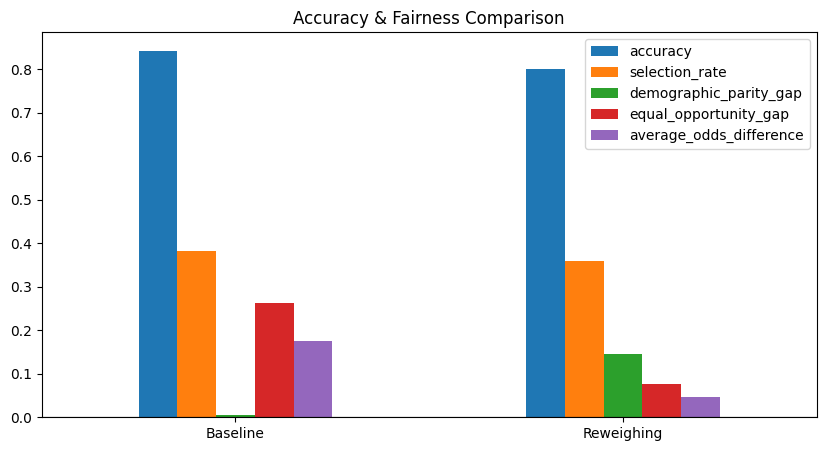

In [138]:
summary = pd.DataFrame([baseline_metrics,
                        reweigh_metrics],
                       index=["Baseline","Reweighing"])

summary.rename(columns={
    "dp_gap"         : "demographic_parity_gap",
    "eq_gap"         : "equal_opportunity_gap",
    "avg_odds"       : "average_odds_difference"
}, inplace=True)

print("\n=== Fairness & Accuracy ===")
display(summary)

summary.plot(kind="bar", figsize=(10,5))
plt.xticks(rotation=0); plt.title("Accuracy & Fairness Comparison")
plt.axhline(0, color="black", lw=.8); plt.show()